In [ ]:
# !pip install pyarrow

# Goal : Predict National Policy Changes based on case data 


[dataset src](https://data.cdc.gov/Case-Surveillance/United-States-COVID-19-Cases-and-Deaths-by-State-o/9mfq-cb36/data)

## Exploring Policy Data

In [1]:
import numpy as np
import pandas as pd
import matplotlib 
from matplotlib import pyplot as plt

import pyspark.pandas as ps
from pyspark.sql import SparkSession

In [2]:
dfP = pd.read_csv('./2022_policy/USA_policy_2022.csv',parse_dates=['Date'])
dfP2 = pd.read_csv('./2021_policy/USA_policy_2021.csv',parse_dates=['Date'])
type(dfP)

/var/folders/c8/z7rkgj2x1fz_257xzx4c_vdh0000gn/T/ipykernel_64301/2351206004.py:2: DtypeWarning: Columns (74) have mixed types. Specify dtype option on import or set low_memory=False.
  dfP2 = pd.read_csv('./2021_policy/USA_policy_2021.csv',parse_dates=['Date'])


pandas.core.frame.DataFrame

In [3]:
psdf = ps.from_pandas(dfP)
psdf2 = ps.from_pandas(dfP2)
psdf

Using Spark's default log4j profile: org/apache/spark/log4j-defaults.properties
Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).
22/05/19 14:43:01 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable
22/05/19 14:43:09 WARN package: Truncated the string representation of a plan since it was too large. This behavior can be adjusted by setting 'spark.sql.debug.maxToStringFields'.


,Unnamed: 0,CountryName,CountryCode,RegionName,RegionCode,Jurisdiction,Date,C1_School closing,C1_Flag,C1_Notes,C2_Workplace closing,C2_Flag,C2_Notes,C3_Cancel public events,C3_Flag,C3_Notes,C4_Restrictions on gatherings,C4_Flag,C4_Notes,C5_Close public transport,C5_Flag,C5_Notes,C6_Stay at home requirements,C6_Flag,C6_Notes,C7_Restrictions on internal movement,C7_Flag,C7_Notes,C8_International travel controls,C8_Notes,E1_Income support,E1_Flag,E1_Notes,E2_Debt/contract relief,E2_Notes,E3_Fiscal measures,E3_Notes,E4_International support,E4_Notes,H1_Public information campaigns,H1_Flag,H1_Notes,H2_Testing policy,H2_Notes,H3_Contact tracing,H3_Notes,H4_Emergency investment in healthcare,H4_Notes,H5_Investment in vaccines,H5_Notes,H6_Facial Coverings,H6_Flag,H6_Notes,H7_Vaccination policy,H7_Flag,H7_Notes,H8_Protection of elderly people,H8_Flag,H8_Notes,M1_Wildcard,M1_Notes,V1_Vaccine Prioritisation (summary),V1_Notes,V2A_Vaccine Availability (summary),V2_Notes,V2B_Vaccine age eligibility/availability age floor (general population summary),V2C_Vaccine age eligibility/availability age floor (at risk summary),V2D_Medically/ clinically vulnerable (Non-elderly),V2E_Education,V2F_Frontline workers (non healthcare),V2G_Frontline workers (healthcare),V3_Vaccine Financial Support (summary),V3_Notes,V4_Mandatory Vaccination (summary),V4_Notes,ConfirmedCases,ConfirmedDeaths,StringencyIndex,StringencyIndexForDisplay,StringencyLegacyIndex,StringencyLegacyIndexForDisplay,GovernmentResponseIndex,GovernmentResponseIndexForDisplay,ContainmentHealthIndex,ContainmentHealthIndexForDisplay,EconomicSupportIndex,EconomicSupportIndexForDisplay
0,41144,United States,USA,None,None,NAT_TOTAL,2022-01-01,2.0,0.0,None,2.0,0.0,None,1.0,0.0,None,4.0,0.0,None,1.0,0.0,None,1.0,0.0,None,1.0,0.0,None,4.0,None,0.0,NaN,None,0.0,None,NaN,NaN,NaN,NaN,2.0,1.0,None,3.0,None,1.0,None,NaN,NaN,NaN,None,3.0,0.0,None,5.0,1.0,None,2.0,0.0,None,NaN,None,2.0,None,3.0,None,5-15 yrs,5-15 yrs,2.0,2.0,2.0,2.0,5.0,None,1.0,None,55024431.0,824701.0,53.24,53.24,63.81,63.81,52.60,52.60,60.12,60.12,0.0,0.0
1,41145,United States,USA,None,None,NAT_TOTAL,2022-01-02,2.0,0.0,None,2.0,0.0,None,1.0,0.0,None,4.0,0.0,None,1.0,0.0,None,1.0,0.0,None,1.0,0.0,None,4.0,None,0.0,NaN,None,0.0,None,NaN,NaN,NaN,NaN,2.0,1.0,None,3.0,None,1.0,None,NaN,NaN,NaN,None,3.0,0.0,None,5.0,1.0,None,2.0,0.0,None,NaN,None,2.0,None,3.0,None,5-15 yrs,5-15 yrs,2.0,2.0,2.0,2.0,5.0,None,1.0,None,55310357.0,825082.0,53.24,53.24,63.81,63.81,52.60,52.60,60.12,60.12,0.0,0.0
2,41146,United States,USA,None,None,NAT_TOTAL,2022-01-03,2.0,0.0,None,2.0,0.0,None,1.0,0.0,None,4.0,0.0,None,1.0,0.0,None,1.0,0.0,None,1.0,0.0,None,4.0,None,0.0,NaN,None,0.0,None,NaN,NaN,NaN,NaN,2.0,1.0,None,3.0,None,1.0,None,NaN,NaN,NaN,None,3.0,0.0,None,5.0,1.0,None,2.0,0.0,None,NaN,None,2.0,None,3.0,None,5-15 yrs,5-15 yrs,2.0,2.0,2.0,2.0,5.0,None,1.0,None,56355277.0,826926.0,53.24,53.24,63.81,63.81,52.60,52.60,60.12,60.12,0.0,0.0
3,41147,United States,USA,None,None,NAT_TOTAL,2022-01-04,2.0,0.0,Several school districts across the country ar...,2.0,0.0,None,1.0,0.0,None,4.0,0.0,None,1.0,0.0,None,1.0,0.0,None,1.0,0.0,None,4.0,"On December 31st, the Biden administration lif...",0.0,NaN,Per the USA government guidance on employment ...,0.0,"On August 26th, the Supreme Court ruled the CD...",NaN,NaN,NaN,NaN,2.0,1.0,The CDC still maintains a robust public inform...,3.0,Testing is generally available across the US. ...,1.0,Although the highest level of contact tracing ...,NaN,NaN,NaN,None,3.0,0.0,None,5.0,1.0,Vaccines are universally available across the ...,2.0,0.0,None,NaN,None,2.0,None,3.0,None,5-15 yrs,5-15 yrs,2.0,2.0,2.0,2.0,5.0,None,1.0,None,57167441.0,829230.0,53.24,53.24,63.81,63.81,52.60,52.60,60.12,60.12,0.0,0.0
4,41148,United States,USA,None,None,NAT_TOTAL,2022-01-05,2.0,0.0,None,2.0,0.0,None,1.0,0.0,None,4.0,0.0,None,1.0,0.0,None,1.0,0.0,None,1.0,0.0,None,4.0,None,0.0,NaN,None,0.0,None,NaN,NaN,NaN,NaN,2.0,1.0,None,3.0,None,1.0,None,NaN,NaN,NaN,None

In [4]:
# National Policies
dfP[dfP['Jurisdiction']=='NAT_TOTAL']

,Unnamed: 0,CountryName,CountryCode,RegionName,RegionCode,Jurisdiction,Date,C1_School closing,C1_Flag,C1_Notes,...,StringencyIndex,StringencyIndexForDisplay,StringencyLegacyIndex,StringencyLegacyIndexForDisplay,GovernmentResponseIndex,GovernmentResponseIndexForDisplay,ContainmentHealthIndex,ContainmentHealthIndexForDisplay,EconomicSupportIndex,EconomicSupportIndexForDisplay
0,41144,United States,USA,NaN,NaN,NAT_TOTAL,2022-01-01,2.0,0.0,NaN,...,53.24,53.24,63.81,63.81,52.6,52.60,60.12,60.12,0.0,0.0
1,41145,United States,USA,NaN,NaN,NAT_TOTAL,2022-01-02,2.0,0.0,NaN,...,53.24,53.24,63.81,63.81,52.6,52.60,60.12,60.12,0.0,0.0
2,41146,United States,USA,NaN,NaN,NAT_TOTAL,2022-01-03,2.0,0.0,NaN,...,53.24,53.24,63.81,63.81,52.6,52.60,60.12,60.12,0.0,0.0
3,41147,United States,USA,NaN,NaN,NAT_TOTAL,2022-01-04,2.0,0.0,Several school districts across the country ar...,...,53.24,53.24,63.81,63.81,52.6,52.60,60.12,60.12,0.0,0.0
4,41148,United States,USA,NaN,NaN,NAT_TOTAL,2022-01-05,2.0,0.0,NaN,...,53.24,53.24,63.81,63.81,52.6,52.60,60.12,60.12,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,41278,United States,USA,NaN,NaN,NAT_TOTAL,2022-05-15,NaN,NaN,NaN,...,NaN,58.80,NaN,66.67,NaN,57.81,NaN,66.07,NaN,0.0
135,41279,United States,USA,NaN,NaN,NAT_TOTAL,2022-05-16,NaN,NaN,NaN,...,NaN,58.80,NaN,66.67,NaN,57.81,NaN,66.07,NaN,0.0
136,41280,United States,USA,NaN,NaN,NAT_TOTAL,2022-05-17,NaN,NaN,NaN,...,NaN,58.80,NaN,66.67,NaN,57.81,NaN,66.07,NaN,0.0
137,41281,United States,USA,NaN,NaN,NAT_TOTAL,2022-05-18,NaN,NaN,NaN,...,NaN,58.80,NaN,66.67,NaN,57.81,NaN,66.07,NaN,0.0


In [5]:
# State Policies
dfP[dfP['Jurisdiction']=='STATE_TOTAL']

,Unnamed: 0,CountryName,CountryCode,RegionName,RegionCode,Jurisdiction,Date,C1_School closing,C1_Flag,C1_Notes,...,StringencyIndex,StringencyIndexForDisplay,StringencyLegacyIndex,StringencyLegacyIndexForDisplay,GovernmentResponseIndex,GovernmentResponseIndexForDisplay,ContainmentHealthIndex,ContainmentHealthIndexForDisplay,EconomicSupportIndex,EconomicSupportIndexForDisplay
139,41283,United States,USA,Alaska,US_AK,STATE_TOTAL,2022-01-01,1.0,0.0,NaN,...,45.83,45.83,58.33,58.33,48.96,48.96,52.38,52.38,25.0,25.0
140,41284,United States,USA,Alaska,US_AK,STATE_TOTAL,2022-01-02,1.0,0.0,NaN,...,45.83,45.83,58.33,58.33,48.96,48.96,52.38,52.38,25.0,25.0
141,41285,United States,USA,Alaska,US_AK,STATE_TOTAL,2022-01-03,1.0,0.0,NaN,...,45.83,45.83,58.33,58.33,48.96,48.96,52.38,52.38,25.0,25.0
142,41286,United States,USA,Alaska,US_AK,STATE_TOTAL,2022-01-04,1.0,0.0,NaN,...,45.83,45.83,58.33,58.33,48.96,48.96,52.38,52.38,25.0,25.0
143,41287,United States,USA,Alaska,US_AK,STATE_TOTAL,2022-01-05,1.0,0.0,NaN,...,45.83,45.83,58.33,58.33,48.96,48.96,52.38,52.38,25.0,25.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7223,48367,United States,USA,Wyoming,US_WY,STATE_TOTAL,2022-05-15,0.0,NaN,NaN,...,27.78,27.78,38.10,38.10,NaN,NaN,35.71,35.71,NaN,NaN
7224,48368,United States,USA,Wyoming,US_WY,STATE_TOTAL,2022-05-16,0.0,NaN,NaN,...,27.78,27.78,38.10,38.10,NaN,NaN,35.71,35.71,NaN,NaN
7225,48369,United States,USA,Wyoming,US_WY,STATE_TOTAL,2022-05-17,0.0,NaN,NaN,...,27.78,27.78,38.10,38.10,NaN,NaN,35.71,35.71,NaN,NaN
7226,48370,United States,USA,Wyoming,US_WY,STATE_TOTAL,2022-05-18,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
# Policy Data 
dfNP = dfP[dfP['Jurisdiction']=='NAT_TOTAL']

In [7]:
dfNP.columns

Index(['Unnamed: 0', 'CountryName', 'CountryCode', 'RegionName', 'RegionCode',
       'Jurisdiction', 'Date', 'C1_School closing', 'C1_Flag', 'C1_Notes',
       'C2_Workplace closing', 'C2_Flag', 'C2_Notes',
       'C3_Cancel public events', 'C3_Flag', 'C3_Notes',
       'C4_Restrictions on gatherings', 'C4_Flag', 'C4_Notes',
       'C5_Close public transport', 'C5_Flag', 'C5_Notes',
       'C6_Stay at home requirements', 'C6_Flag', 'C6_Notes',
       'C7_Restrictions on internal movement', 'C7_Flag', 'C7_Notes',
       'C8_International travel controls', 'C8_Notes', 'E1_Income support',
       'E1_Flag', 'E1_Notes', 'E2_Debt/contract relief', 'E2_Notes',
       'E3_Fiscal measures', 'E3_Notes', 'E4_International support',
       'E4_Notes', 'H1_Public information campaigns', 'H1_Flag', 'H1_Notes',
       'H2_Testing policy', 'H2_Notes', 'H3_Contact tracing', 'H3_Notes',
       'H4_Emergency investment in healthcare', 'H4_Notes',
       'H5_Investment in vaccines', 'H5_Notes', 'H6_Faci

In [8]:
dfNP = dfNP[['Date',
      'C1_School closing',
      'C2_Workplace closing',
      'C3_Cancel public events',
     'C5_Close public transport',
      'H2_Testing policy'
     ]]



In [9]:
dfNP.sort_values(by=['Date'])

,Date,C1_School closing,C2_Workplace closing,C3_Cancel public events,C5_Close public transport,H2_Testing policy
0,2022-01-01,2.0,2.0,1.0,1.0,3.0
1,2022-01-02,2.0,2.0,1.0,1.0,3.0
2,2022-01-03,2.0,2.0,1.0,1.0,3.0
3,2022-01-04,2.0,2.0,1.0,1.0,3.0
4,2022-01-05,2.0,2.0,1.0,1.0,3.0
...,...,...,...,...,...,...
134,2022-05-15,NaN,NaN,NaN,NaN,NaN
135,2022-05-16,NaN,NaN,NaN,NaN,NaN
136,2022-05-17,NaN,NaN,NaN,NaN,NaN
137,2022-05-18,NaN,NaN,NaN,NaN,NaN


In [10]:
dfNP.loc[:,'C1_School closing'].rolling(window=2).apply(lambda x: x.iloc[1] - x.iloc[0]).unique()

array([nan,  0.])

# This is a cool insight 
No policy changes made this year  (interesting) __wrt School Closing__



# 1.0 FRAMEWORK OF WORK

In [11]:
# Upload Any policy Data

polData1 = pd.read_csv('./2022_policy/USA_policy_2022.csv',parse_dates=['Date'])
polData2 = pd.read_csv('./2021_policy/USA_policy_2021.csv',parse_dates=['Date'])


polData = pd.concat([polData1,polData2])
polData = polData.reset_index()

# Only Consider National Policies 
polData = polData[polData['Jurisdiction']=='NAT_TOTAL']

/var/folders/c8/z7rkgj2x1fz_257xzx4c_vdh0000gn/T/ipykernel_64301/1390775904.py:4: DtypeWarning: Columns (74) have mixed types. Specify dtype option on import or set low_memory=False.
  polData2 = pd.read_csv('./2021_policy/USA_policy_2021.csv',parse_dates=['Date'])


In [12]:
polData.columns

Index(['index', 'Unnamed: 0', 'CountryName', 'CountryCode', 'RegionName',
       'RegionCode', 'Jurisdiction', 'Date', 'C1_School closing', 'C1_Flag',
       'C1_Notes', 'C2_Workplace closing', 'C2_Flag', 'C2_Notes',
       'C3_Cancel public events', 'C3_Flag', 'C3_Notes',
       'C4_Restrictions on gatherings', 'C4_Flag', 'C4_Notes',
       'C5_Close public transport', 'C5_Flag', 'C5_Notes',
       'C6_Stay at home requirements', 'C6_Flag', 'C6_Notes',
       'C7_Restrictions on internal movement', 'C7_Flag', 'C7_Notes',
       'C8_International travel controls', 'C8_Notes', 'E1_Income support',
       'E1_Flag', 'E1_Notes', 'E2_Debt/contract relief', 'E2_Notes',
       'E3_Fiscal measures', 'E3_Notes', 'E4_International support',
       'E4_Notes', 'H1_Public information campaigns', 'H1_Flag', 'H1_Notes',
       'H2_Testing policy', 'H2_Notes', 'H3_Contact tracing', 'H3_Notes',
       'H4_Emergency investment in healthcare', 'H4_Notes',
       'H5_Investment in vaccines', 'H5_Notes',

In [13]:
# Pick Columns of Policy Interested 
polColumns = [
    'C1_School closing',
    'C6_Stay at home requirements',
    'C2_Workplace closing',
    'C7_Restrictions on internal movement',
    'C3_Cancel public events',
    'C4_Restrictions on gatherings',
    'C5_Close public transport',
    'H2_Testing policy'
]


In [14]:
# National Policies
polData = polData[polColumns+['Date']]

In [15]:
polData = polData.sort_values(by=['Date'])

In [16]:
for policyName  in polColumns:
    polData['diff_'+policyName] = polData.loc[:,policyName].rolling(window=2).apply(lambda x: x.iloc[1] - x.iloc[0])

In [17]:
polData

,C1_School closing,C6_Stay at home requirements,C2_Workplace closing,C7_Restrictions on internal movement,C3_Cancel public events,C4_Restrictions on gatherings,C5_Close public transport,H2_Testing policy,Date,diff_C1_School closing,diff_C6_Stay at home requirements,diff_C2_Workplace closing,diff_C7_Restrictions on internal movement,diff_C3_Cancel public events,diff_C4_Restrictions on gatherings,diff_C5_Close public transport,diff_H2_Testing policy
7228,3.0,2.0,2.0,2.0,2.0,4.0,1.0,3.0,2021-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7229,3.0,2.0,2.0,2.0,2.0,4.0,1.0,3.0,2021-01-02,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7230,3.0,2.0,2.0,2.0,2.0,4.0,1.0,3.0,2021-01-03,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7231,3.0,2.0,2.0,2.0,2.0,4.0,1.0,3.0,2021-01-04,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7232,3.0,2.0,2.0,2.0,2.0,4.0,1.0,3.0,2021-01-05,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022-05-15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
135,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022-05-16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
136,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022-05-17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
137,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022-05-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [18]:
polData

,C1_School closing,C6_Stay at home requirements,C2_Workplace closing,C7_Restrictions on internal movement,C3_Cancel public events,C4_Restrictions on gatherings,C5_Close public transport,H2_Testing policy,Date,diff_C1_School closing,diff_C6_Stay at home requirements,diff_C2_Workplace closing,diff_C7_Restrictions on internal movement,diff_C3_Cancel public events,diff_C4_Restrictions on gatherings,diff_C5_Close public transport,diff_H2_Testing policy
7228,3.0,2.0,2.0,2.0,2.0,4.0,1.0,3.0,2021-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7229,3.0,2.0,2.0,2.0,2.0,4.0,1.0,3.0,2021-01-02,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7230,3.0,2.0,2.0,2.0,2.0,4.0,1.0,3.0,2021-01-03,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7231,3.0,2.0,2.0,2.0,2.0,4.0,1.0,3.0,2021-01-04,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7232,3.0,2.0,2.0,2.0,2.0,4.0,1.0,3.0,2021-01-05,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022-05-15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
135,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022-05-16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
136,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022-05-17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
137,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022-05-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [19]:
DATELIST = []

for policyName  in polColumns:
    diffColumn = 'diff_'+policyName
    
    dates_of_change = polData.dropna()[polData[diffColumn]!=0]['Date'].to_list()
    values_of_change = polData.dropna()[polData[diffColumn]!=0][diffColumn].to_list()
    DATELIST.append({
        'policy_name' : policyName,
        'dates_of_change':dates_of_change,
        'value' : values_of_change
    })
    

/var/folders/c8/z7rkgj2x1fz_257xzx4c_vdh0000gn/T/ipykernel_64301/3840341055.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  dates_of_change = polData.dropna()[polData[diffColumn]!=0]['Date'].to_list()
/var/folders/c8/z7rkgj2x1fz_257xzx4c_vdh0000gn/T/ipykernel_64301/3840341055.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  values_of_change = polData.dropna()[polData[diffColumn]!=0][diffColumn].to_list()


In [20]:
DATELIST

[{'policy_name': 'C1_School closing',
  'dates_of_change': [Timestamp('2021-02-03 00:00:00'),
   Timestamp('2021-05-09 00:00:00'),
   Timestamp('2021-05-23 00:00:00')],
  'value': [-1.0, -1.0, 1.0]},
 {'policy_name': 'C6_Stay at home requirements',
  'dates_of_change': [Timestamp('2021-03-04 00:00:00')],
  'value': [-1.0]},
 {'policy_name': 'C2_Workplace closing',
  'dates_of_change': [Timestamp('2021-03-23 00:00:00'),
   Timestamp('2021-06-14 00:00:00'),
   Timestamp('2021-07-08 00:00:00'),
   Timestamp('2021-08-10 00:00:00'),
   Timestamp('2021-08-30 00:00:00'),
   Timestamp('2021-09-13 00:00:00')],
  'value': [-1.0, 1.0, -1.0, 1.0, -1.0, 1.0]},
 {'policy_name': 'C7_Restrictions on internal movement',
  'dates_of_change': [Timestamp('2021-03-29 00:00:00'),
   Timestamp('2021-06-14 00:00:00'),
   Timestamp('2021-09-01 00:00:00'),
   Timestamp('2022-03-16 00:00:00')],
  'value': [-1.0, 1.0, -1.0, 1.0]},
 {'policy_name': 'C3_Cancel public events',
  'dates_of_change': [Timestamp('2021-0

-----

## 2.0 Exploring Case Data 

In [21]:
# Case Data Processing 
dfC = pd.read_csv('./db.csv',parse_dates=['submission_date'])
dfC = dfC.sort_values(by='submission_date',ascending=True)
dfC

,submission_date,state,tot_cases,conf_cases,prob_cases,new_case,pnew_case,tot_death,conf_death,prob_death,new_death,pnew_death,created_at,consent_cases,consent_deaths
22214,2020-01-22,OH,0,NaN,NaN,0,NaN,0,NaN,NaN,0,NaN,03/26/2020 04:22:39 PM,Agree,Agree
6968,2020-01-22,NC,0,NaN,NaN,0,NaN,0,NaN,NaN,0,NaN,03/26/2020 04:22:39 PM,Agree,Agree
36922,2020-01-22,WA,0,NaN,NaN,0,0.0,0,NaN,NaN,0,0.0,01/22/2020 12:00:00 AM,NaN,NaN
10439,2020-01-22,VA,0,NaN,NaN,0,NaN,0,NaN,NaN,0,NaN,03/26/2020 04:22:39 PM,Agree,Agree
40999,2020-01-22,MD,0,NaN,NaN,0,0.0,0,0.0,0.0,0,0.0,01/24/2020 12:00:00 AM,NaN,Agree
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25963,2022-05-16,AR,838684,NaN,NaN,74,0.0,11418,NaN,NaN,2,0.0,05/17/2022 01:42:49 PM,Not agree,Not agree
39777,2022-05-16,NC,2691805,2244381.0,447424.0,0,0.0,24588,21428.0,3160.0,0,0.0,05/17/2022 01:42:49 PM,Agree,Agree
15014,2022-05-16,MA,1821071,1674693.0,146378.0,11762,973.0,20409,19261.0,1148.0,16,7.0,05/17/2022 01:42:49 PM,Agree,Agree
9805,2022-05-16,DC,145846,NaN,NaN,659,0.0,1342,NaN,NaN,1,0.0,05/17/2022 01:42:49 PM,NaN,NaN


In [22]:
dfC_proc = dfC[['submission_date','new_case','new_death']].groupby('submission_date').sum()

In [23]:
dfC_proc.columns

Index(['new_case', 'new_death'], dtype='object')

<AxesSubplot:xlabel='submission_date'>

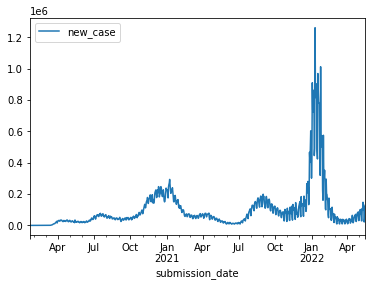

In [24]:
dfC_proc.plot(y='new_case')

In [25]:
dfC_proc['new_case_MA20'] = dfC_proc.loc[:,'new_case'].rolling(window=20).mean()
dfC_proc['new_death_MA20'] = dfC_proc.loc[:,'new_death'].rolling(window=20).mean()

In [26]:
dfC_proc.dropna(inplace=True)

In [27]:
dfC_proc

,new_case,new_death,new_case_MA20,new_death_MA20
submission_date,,,,
2020-02-10,0,0,0.60,0.00
2020-02-11,0,0,0.60,0.00
2020-02-12,1,0,0.60,0.00
2020-02-13,1,0,0.60,0.00
2020-02-14,0,0,0.60,0.00
...,...,...,...,...
2022-05-12,101200,253,70014.55,292.65
2022-05-13,116893,429,74490.90,311.00
2022-05-14,21733,46,74320.85,310.55


<AxesSubplot:xlabel='submission_date'>

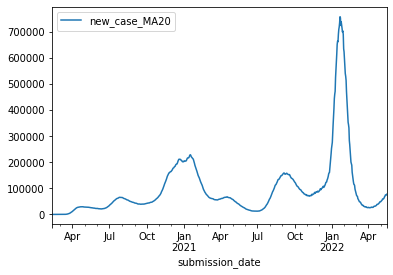

In [28]:
dfC_proc.plot(y='new_case_MA20')

<AxesSubplot:xlabel='submission_date'>

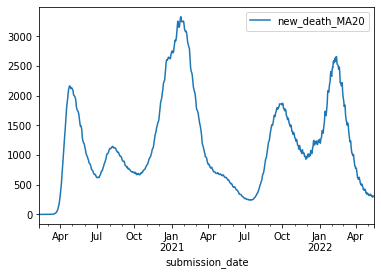

In [29]:
dfC_proc.plot(y='new_death_MA20')

<AxesSubplot:xlabel='submission_date'>

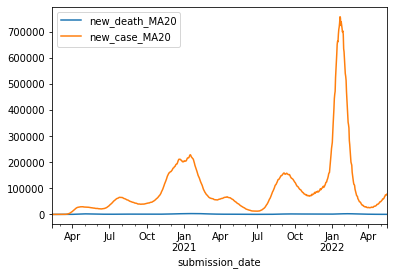

In [30]:
dfC_proc.plot(y=['new_death_MA20','new_case_MA20'])

# 3.0 Fusion 

In [31]:
dfC_proc

,new_case,new_death,new_case_MA20,new_death_MA20
submission_date,,,,
2020-02-10,0,0,0.60,0.00
2020-02-11,0,0,0.60,0.00
2020-02-12,1,0,0.60,0.00
2020-02-13,1,0,0.60,0.00
2020-02-14,0,0,0.60,0.00
...,...,...,...,...
2022-05-12,101200,253,70014.55,292.65
2022-05-13,116893,429,74490.90,311.00
2022-05-14,21733,46,74320.85,310.55


In [32]:
for column_name in polColumns:
    dfC_proc[column_name] = 0 

dfC_proc

,new_case,new_death,new_case_MA20,new_death_MA20,C1_School closing,C6_Stay at home requirements,C2_Workplace closing,C7_Restrictions on internal movement,C3_Cancel public events,C4_Restrictions on gatherings,C5_Close public transport,H2_Testing policy
submission_date,,,,,,,,,,,,
2020-02-10,0,0,0.60,0.00,0,0,0,0,0,0,0,0
2020-02-11,0,0,0.60,0.00,0,0,0,0,0,0,0,0
2020-02-12,1,0,0.60,0.00,0,0,0,0,0,0,0,0
2020-02-13,1,0,0.60,0.00,0,0,0,0,0,0,0,0
2020-02-14,0,0,0.60,0.00,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
2022-05-12,101200,253,70014.55,292.65,0,0,0,0,0,0,0,0
2022-05-13,116893,429,74490.90,311.00,0,0,0,0,0,0,0,0
2022-05-14,21733,46,74320.85,310.55,0,0,0,0,0,0,0,0


In [33]:
dfC_proc.reset_index(inplace=True)
dfC_proc


,submission_date,new_case,new_death,new_case_MA20,new_death_MA20,C1_School closing,C6_Stay at home requirements,C2_Workplace closing,C7_Restrictions on internal movement,C3_Cancel public events,C4_Restrictions on gatherings,C5_Close public transport,H2_Testing policy
0,2020-02-10,0,0,0.60,0.00,0,0,0,0,0,0,0,0
1,2020-02-11,0,0,0.60,0.00,0,0,0,0,0,0,0,0
2,2020-02-12,1,0,0.60,0.00,0,0,0,0,0,0,0,0
3,2020-02-13,1,0,0.60,0.00,0,0,0,0,0,0,0,0
4,2020-02-14,0,0,0.60,0.00,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
822,2022-05-12,101200,253,70014.55,292.65,0,0,0,0,0,0,0,0
823,2022-05-13,116893,429,74490.90,311.00,0,0,0,0,0,0,0,0
824,2022-05-14,21733,46,74320.85,310.55,0,0,0,0,0,0,0,0
825,2022-05-15,45491,40,73985.40,302.90,0,0,0,0,0,0,0,0


In [34]:
DATELIST

[{'policy_name': 'C1_School closing',
  'dates_of_change': [Timestamp('2021-02-03 00:00:00'),
   Timestamp('2021-05-09 00:00:00'),
   Timestamp('2021-05-23 00:00:00')],
  'value': [-1.0, -1.0, 1.0]},
 {'policy_name': 'C6_Stay at home requirements',
  'dates_of_change': [Timestamp('2021-03-04 00:00:00')],
  'value': [-1.0]},
 {'policy_name': 'C2_Workplace closing',
  'dates_of_change': [Timestamp('2021-03-23 00:00:00'),
   Timestamp('2021-06-14 00:00:00'),
   Timestamp('2021-07-08 00:00:00'),
   Timestamp('2021-08-10 00:00:00'),
   Timestamp('2021-08-30 00:00:00'),
   Timestamp('2021-09-13 00:00:00')],
  'value': [-1.0, 1.0, -1.0, 1.0, -1.0, 1.0]},
 {'policy_name': 'C7_Restrictions on internal movement',
  'dates_of_change': [Timestamp('2021-03-29 00:00:00'),
   Timestamp('2021-06-14 00:00:00'),
   Timestamp('2021-09-01 00:00:00'),
   Timestamp('2022-03-16 00:00:00')],
  'value': [-1.0, 1.0, -1.0, 1.0]},
 {'policy_name': 'C3_Cancel public events',
  'dates_of_change': [Timestamp('2021-0

In [35]:
for dateset in DATELIST:
    print(dateset['policy_name'])
    for index,change_date in enumerate(dateset['dates_of_change']):
        print('\t',change_date)
        idx = dfC_proc[dfC_proc['submission_date']==change_date].index[0]
        dfC_proc.at[idx,dateset['policy_name']]=dfC_proc.loc[idx]['new_case_MA20']*dateset['value'][index]
        

C1_School closing
	 2021-02-03 00:00:00
	 2021-05-09 00:00:00
	 2021-05-23 00:00:00
C6_Stay at home requirements
	 2021-03-04 00:00:00
C2_Workplace closing
	 2021-03-23 00:00:00
	 2021-06-14 00:00:00
	 2021-07-08 00:00:00
	 2021-08-10 00:00:00
	 2021-08-30 00:00:00
	 2021-09-13 00:00:00
C7_Restrictions on internal movement
	 2021-03-29 00:00:00
	 2021-06-14 00:00:00
	 2021-09-01 00:00:00
	 2022-03-16 00:00:00
C3_Cancel public events
	 2021-03-23 00:00:00
	 2021-06-14 00:00:00
	 2021-07-08 00:00:00
	 2021-08-30 00:00:00
	 2021-11-30 00:00:00
	 2022-01-19 00:00:00
C4_Restrictions on gatherings
	 2021-07-08 00:00:00
	 2021-08-10 00:00:00
	 2021-11-30 00:00:00
	 2021-12-27 00:00:00
	 2022-02-28 00:00:00
C5_Close public transport
H2_Testing policy


<AxesSubplot:xlabel='submission_date'>

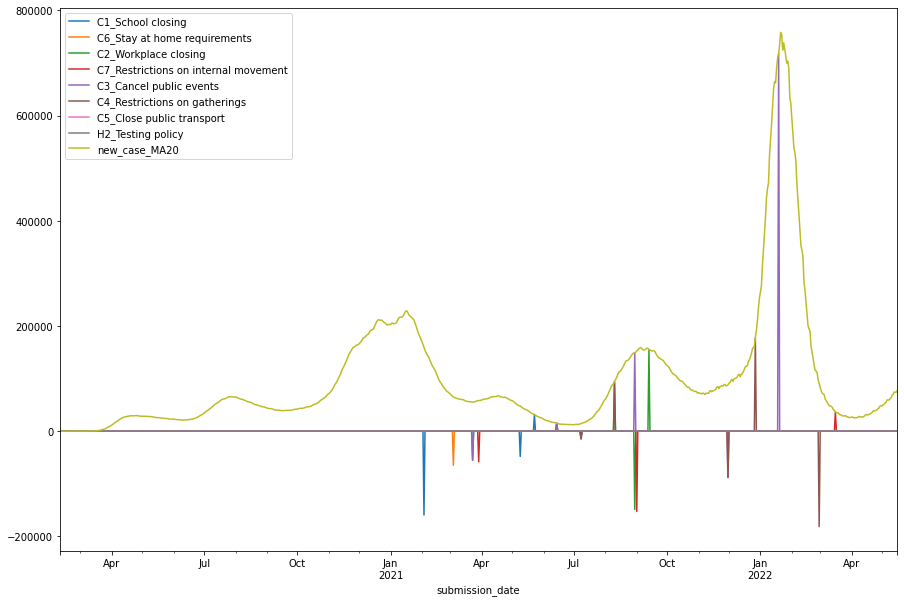

In [36]:

matplotlib.rcParams['figure.figsize'] = [15, 10]
dfC_proc.plot(x='submission_date',y=polColumns+['new_case_MA20'])

In [37]:
# fig, axs = plt.subplots(1)
# fig.suptitle('Vertically stacked subplots')
# axs.plot(dfC_proc['submission_date'],dfC_proc['new_case_MA20'])
# axs.scatter(dfC_proc['submission_date'],dfC_proc['C1_School closing'])
# axs.scatter(dfC_proc['submission_date'],dfC_proc['C2_Workplace closing'])
# axs.scatter(dfC_proc['submission_date'],dfC_proc['C7_Restrictions on internal movement'])


In [38]:
# from matplotlib import pyplot as plt